<a href="https://colab.research.google.com/github/AnouarDahdah/SDF_Geometric_Pram/blob/main/sdf_parametrization_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install torch torchvision torchaudio
!pip install torchdiffeq
!pip install numpy matplotlib
!pip install py7zr
!pip install trimesh
!pip install scipy
!pip install Delaunay

First few rows of the dataset:
                          0                          1  \
0                         X                          Y   
1  2.560695233496495860e+00  -2.006629950233543291e-01   
2  2.553546202896108230e+00  -1.998907556861558577e-01   
3  2.553108722551854726e+00  -1.998135101854471296e-01   
4  2.560691505636216281e+00  -2.007044766604119679e-01   

                          2  
0                         Z  
1  4.531905238959892390e-01  
2  4.531844950385591764e-01  
3  4.451716889875768635e-01  
4  4.451801288792983646e-01  

Data types of each column:
0    object
1    object
2    object
dtype: object
Number of vertices: 2182476
Epoch 0, Loss: 0.89664626121521
Epoch 100, Loss: 0.13705144822597504
Epoch 200, Loss: 0.06820063292980194
Epoch 300, Loss: 0.024540627375245094
Epoch 400, Loss: 0.007580198347568512
Epoch 500, Loss: 0.0034762630239129066
Epoch 600, Loss: 0.002796401269733906
Epoch 700, Loss: 0.001958215143531561
Epoch 800, Loss: 0.001742950524203479

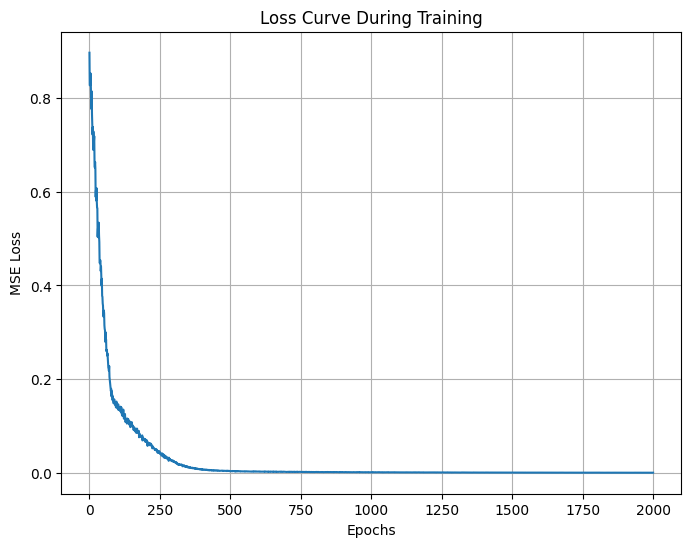

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import numpy as np
from scipy.spatial import cKDTree
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import pandas as pd

# Step 1: Load the CSV file containing XYZ coordinates
csv_filename = '/content/datasurfaceSurface1.csv'
data = pd.read_csv(csv_filename, header=None, low_memory=False)

# Step 2: Inspect the loaded data
print("First few rows of the dataset:")
print(data.head())
print("\nData types of each column:")
print(data.dtypes)

# Step 3: Convert all data to numeric, coercing errors to NaN
data = data.apply(pd.to_numeric, errors='coerce')

# Step 4: Drop rows with NaN values to keep only numeric data
if data.isnull().values.any():
    print("Warning: Non-numeric values found and removed.")
    data = data.dropna()  # Remove rows with NaN values

# Convert cleaned data to a NumPy array
vertices = data.values

# Print the number of vertices
print(f"Number of vertices: {len(vertices)}")

# Step 5: Set up a 3D grid for initializing SDF values
grid_resolution = 50  # Resolution of the 3D grid
x_min, x_max = vertices[:, 0].min() - 1, vertices[:, 0].max() + 1
y_min, y_max = vertices[:, 1].min() - 1, vertices[:, 1].max() + 1
z_min, z_max = vertices[:, 2].min() - 1, vertices[:, 2].max() + 1

# Create a 3D grid spanning the XYZ bounds
x = np.linspace(x_min, x_max, grid_resolution)
y = np.linspace(y_min, y_max, grid_resolution)
z = np.linspace(z_min, z_max, grid_resolution)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Step 6: Set up KD-Tree for fast nearest-neighbor search to calculate SDF
tree = cKDTree(vertices)

# Step 7: Compute the SDF as the distance to the nearest surface point
sdf_values = tree.query(grid_points)[0]  # Get distances to the nearest points
sdf_values = torch.tensor(sdf_values, dtype=torch.float32)  # Convert to PyTorch tensor

# Step 8: Define a Multi-Layer Perceptron (MLP) for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input: XYZ + SDF values, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 9: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 10: Neural ODE solver function
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 11: Define the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.0001)

# Training parameters
epochs = 2000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Number of samples per batch

# For plotting the loss curve
loss_history = []

# Step 12: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()  # Reset gradients

    # Sample a batch of grid points randomly
    indices = torch.randperm(grid_points.shape[0])[:batch_size]
    sampled_points = grid_points[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF values as MLP input
    mlp_input = torch.cat((torch.tensor(sampled_points, dtype=torch.float32), sampled_sdf_values.unsqueeze(1)), dim=1)

    # Pass input through MLP to get features
    features = mlp(mlp_input)

    # Refine features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Take final time step's output

    # Predicted SDF values are taken from the first component of refined features
    predicted_sdf = refined_features[:, 0]

    # Calculate the loss between predicted and actual SDF values
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Store the loss for visualization
    loss_history.append(loss.item())

    # Print the loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 13: Model evaluation and prediction
with torch.no_grad():
    # Compute refined SDF values for all grid points
    features = mlp(torch.cat((torch.tensor(grid_points, dtype=torch.float32), sdf_values.unsqueeze(1)), dim=1))
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 14: 3D visualization of the refined SDF
fig = go.Figure(data=[go.Isosurface(
    x=grid_points[:, 0], y=grid_points[:, 1], z=grid_points[:, 2],
    value=refined_sdf_values,
    isomin=0.0, isomax=1.0,
    surface_count=10,
    colorscale='Viridis',
    caps=dict(x_show=False, y_show=False, z_show=False)
)])

fig.update_layout(scene=dict(aspectmode='data'),
                  title='Refined SDF Isosurface of Surface Shape')
fig.show()

# Step 15: Plot the loss curve over the training process
plt.figure(figsize=(8, 6))
plt.plot(loss_history)
plt.title('Loss Curve During Training')
plt.xlabel('Epochs')
plt.ylabel('MSE Loss')
plt.grid(True)
plt.show()


Epoch 0, Loss: 0.1140172928571701
Epoch 100, Loss: 0.00010302979353582487
Epoch 200, Loss: 3.982018097303808e-05
Epoch 300, Loss: 2.1146650396985933e-05
Epoch 400, Loss: 1.4497993106488138e-05
Epoch 500, Loss: 8.59333340486046e-06
Epoch 600, Loss: 3.145598020637408e-05
Epoch 700, Loss: 5.225573204370448e-06
Epoch 800, Loss: 5.3361272875918075e-06
Epoch 900, Loss: 4.078170150023652e-06


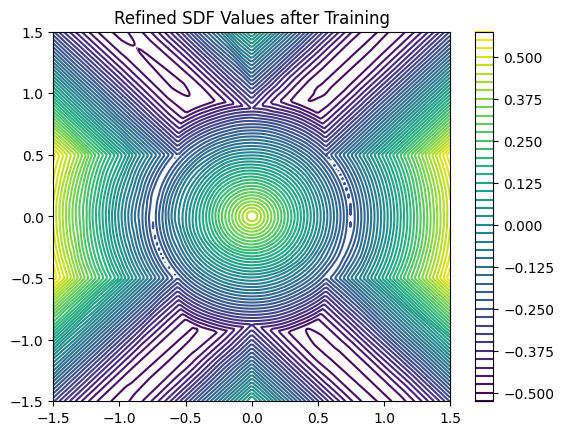

In [ ]:
import torch
import torch.nn as nn
import numpy as np
from torchdiffeq import odeint
import matplotlib.pyplot as plt

# Step 3: Defining the Hexagon and Circular Hole SDFs
def hexagon_sdf(points, radius=1.0):
    k = np.array([np.sqrt(3)/2, 0.5])
    p = np.abs(points[:, :2])
    p -= 2.0 * np.minimum(np.dot(p, k), 0.0)[:, None] * k
    p -= np.clip(p[:, 1] - radius/2, 0.0, np.inf)[:, None]
    return np.linalg.norm(p, axis=1) - radius

def circle_sdf(points, radius=0.5):
    return np.linalg.norm(points[:, :2], axis=1) - radius

# Generate points in a grid
x = np.linspace(-1.5, 1.5, 200)
y = np.linspace(-1.5, 1.5, 200)
xx, yy = np.meshgrid(x, y)
points = np.vstack((xx.ravel(), yy.ravel())).T
points = np.hstack((points, np.zeros((points.shape[0], 1))))  # Add z dimension

# Compute SDF values
hex_sdf = hexagon_sdf(points)
circle_sdf = circle_sdf(points)
sdf_values = np.maximum(hex_sdf, -circle_sdf)

# Convert to PyTorch tensors
points = torch.tensor(points, dtype=torch.float32)
sdf_values = torch.tensor(sdf_values, dtype=torch.float32)

# Step 5: Feature Extraction with MLP
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)  # Reduced hidden dimension

# Step 6: Neural ODE Layer
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

ode_func = ODEFunc(hidden_dim=64)

# ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 7: Training Setup
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 1000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of points for training
    indices = torch.randperm(points.size(0))[:batch_size]
    sampled_points = points[indices]
    sampled_sdf_values = sdf_values[indices]

    features = mlp(torch.cat((sampled_points, sampled_sdf_values.unsqueeze(1)), dim=1))

    refined_features = neural_ode(features, t)[-1]

    predicted_sdf = refined_features[:, 0]
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    loss.backward()

    # Gradient clipping
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)

    optimizer.step()

    # Print loss
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and Visualization of the Refined SDF after Training
with torch.no_grad():
    features = mlp(torch.cat((points, sdf_values.unsqueeze(1)), dim=1))
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Ensure refined SDF values match grid size (200x200)
refined_sdf_values = refined_sdf_values[:40000]  # Ensure there are 40000 points for the grid

# Reshape refined SDF values for contour plot
refined_sdf_values_reshaped = refined_sdf_values.reshape(xx.shape)

# Visualization of the refined SDF using contour plot
plt.contour(xx, yy, refined_sdf_values_reshaped, levels=50, cmap='viridis')
plt.colorbar()
plt.title('Refined SDF Values after Training')
plt.show()


In [ ]:
import py7zr
import os

# Use the correct file path from the uploaded files
archive_filename = '/content/file-1625344073839.7z'  # Replace with the correct file name
extract_path = './ahmed_body'

# Extract the .7z file
with py7zr.SevenZipFile(archive_filename, mode='r') as archive:
    archive.extractall(path=extract_path)

# List the contents of the extracted folder
extracted_files = []
for root, dirs, files in os.walk(extract_path):
    for file in files:
        extracted_files.append(os.path.join(root, file))

# Display the list of extracted files
extracted_files


['./ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl']

In [ ]:
import trimesh

# Path to the STL file
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'

# Load the STL file
mesh = trimesh.load_mesh(stl_filename)

# Visualize basic info about the mesh
print(mesh)

# Example: Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# You can now proceed with using 'vertices' for your SDF calculations


<trimesh.Trimesh(vertices.shape=(5359, 3), faces.shape=(10714, 3), name=`Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl`)>
Number of vertices: 5359


In [ ]:
import trimesh
import plotly.graph_objects as go

# Step 1: Load the STL file using trimesh
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Step 2: Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Step 3: Extract face data (indices of the vertices that make up each triangle)
faces = mesh.faces

# Step 4: Create a 3D plot using plotly
# Extract x, y, z coordinates of the vertices
x, y, z = vertices[:, 0], vertices[:, 1], vertices[:, 2]

# Create the 3D mesh plot
mesh_plot = go.Mesh3d(
    x=x, y=y, z=z,  # Coordinates of vertices
    i=faces[:, 0], j=faces[:, 1], k=faces[:, 2],  # Indices of the triangle vertices
    color='lightblue',  # Color of the mesh
    opacity=0.5,  # Set the opacity for better visualization
)

# Step 5: Create a figure and plot it
fig = go.Figure(data=[mesh_plot])

# Step 6: Set plot layout for better visuals
fig.update_layout(
    title="3D Mesh Plot of Ahmed Body",
    scene=dict(
        xaxis_title='X-axis',
        yaxis_title='Y-axis',
        zaxis_title='Z-axis',
        aspectmode='data'  # Keep the aspect ratio proportional
    ),
    margin=dict(l=0, r=0, t=50, b=0),  # Adjust margins
)

# Step 7: Show the plot
fig.show()


Number of vertices: 5359


In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
import numpy as np

# Step 1: Load the STL file of the Ahmed Body and extract the vertices
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Convert vertices to a PyTorch tensor
vertices_tensor = torch.tensor(vertices, dtype=torch.float32)

# Step 2: Create dummy SDF values (placeholders) for the vertices
# In practice, these would be precomputed SDF values for the Ahmed Body
sdf_values = torch.randn(vertices_tensor.shape[0])  # Random SDF values for now

# Step 3: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 4: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 5: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 6: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 1000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Step 7: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of vertices for training
    indices = torch.randperm(vertices_tensor.size(0))[:batch_size]
    sampled_vertices = vertices_tensor[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((sampled_vertices, sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all vertices to compute refined SDF values
    mlp_input = torch.cat((vertices_tensor, sdf_values.unsqueeze(1)), dim=1)
    features = mlp(mlp_input)
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Visualization or further evaluation depends on the use case


Number of vertices: 5359
Epoch 0, Loss: 1027.6422119140625
Epoch 100, Loss: 0.9678022861480713


KeyboardInterrupt: 

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from scipy.spatial import Delaunay

# Step 1: Load the STL file of the Ahmed Body and extract the vertices
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Convert vertices to a PyTorch tensor
vertices_tensor = torch.tensor(vertices, dtype=torch.float32)

# Step 2: Create dummy SDF values (placeholders) for the vertices
sdf_values = torch.randn(vertices_tensor.shape[0])  # Random SDF values for now

# Step 3: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 4: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 5: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 6: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 1000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Step 7: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of vertices for training
    indices = torch.randperm(vertices_tensor.size(0))[:batch_size]
    sampled_vertices = vertices_tensor[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((sampled_vertices, sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all vertices to compute refined SDF values
    mlp_input = torch.cat((vertices_tensor, sdf_values.unsqueeze(1)), dim=1)
    features = mlp(mlp_input)
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 9: Create a 3D grid for visualization
x_min, x_max = vertices[:, 0].min(), vertices[:, 0].max()
y_min, y_max = vertices[:, 1].min(), vertices[:, 1].max()
z_min, z_max = vertices[:, 2].min(), vertices[:, 2].max()

x = np.linspace(x_min, x_max, 20)  # Change grid resolution as needed
y = np.linspace(y_min, y_max, 20)
z = np.linspace(z_min, z_max, 20)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Compute SDF for the grid points using refined SDF values (interpolation)
tri = Delaunay(vertices[:, :2])  # 2D Delaunay triangulation for XY plane
grid_sdf_values = np.zeros(xx.shape)

for i in range(grid_points.shape[0]):
    simplex = tri.find_simplex(grid_points[i, :2])  # Only use x, y for simplex
    if simplex >= 0:  # If the point is inside a triangle
        vertices_indices = tri.simplices[simplex]
        # Barycentric coordinates
        bary = tri.transform[simplex, :2].dot(grid_points[i, :2] - tri.transform[simplex, 2])
        if np.all(bary >= 0):
            # Interpolate SDF values
            grid_sdf_values.ravel()[i] = (refined_sdf_values[vertices_indices] @ (1 - bary.sum()))  # A simple interpolation

# Reshape for plotting
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 10: Visualization of the refined SDF using 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Create a surface plot of the SDF values
ax.scatter(xx, yy, zz, c=grid_sdf_values.ravel(), cmap='viridis', alpha=0.5)
ax.set_title('Refined SDF Values of the Ahmed Body')
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')

plt.show()


Number of vertices: 5359
Epoch 0, Loss: 2554.674560546875
Epoch 100, Loss: 1.2623058557510376
Epoch 200, Loss: 0.7504749894142151
Epoch 300, Loss: 0.18997648358345032
Epoch 400, Loss: 0.10647096484899521
Epoch 500, Loss: 0.07263193279504776
Epoch 600, Loss: 0.1666051149368286
Epoch 700, Loss: 0.9491243958473206
Epoch 800, Loss: 0.1495727300643921
Epoch 900, Loss: 0.14216020703315735


ValueError: matmul: Input operand 1 does not have enough dimensions (has 0, gufunc core with signature (n?,k),(k,m?)->(n?,m?) requires 1)

Number of vertices: 5359
Epoch 0, Loss: 501.72357177734375
Epoch 100, Loss: 1.0871576070785522
Epoch 200, Loss: 0.8443816900253296
Epoch 300, Loss: 0.7335554361343384
Epoch 400, Loss: 0.9400436878204346
Epoch 500, Loss: 0.43871811032295227
Epoch 600, Loss: 0.45511266589164734
Epoch 700, Loss: 0.5426487922668457
Epoch 800, Loss: 0.23677505552768707
Epoch 900, Loss: 0.27434808015823364
Epoch 1000, Loss: 0.571710467338562
Epoch 1100, Loss: 0.0851614847779274
Epoch 1200, Loss: 0.01110620703548193
Epoch 1300, Loss: 0.060859888792037964
Epoch 1400, Loss: 0.05574381723999977
Epoch 1500, Loss: 0.1275867372751236
Epoch 1600, Loss: 0.0205728467553854
Epoch 1700, Loss: 0.016828346997499466
Epoch 1800, Loss: 0.015645712614059448
Epoch 1900, Loss: 0.01979137770831585


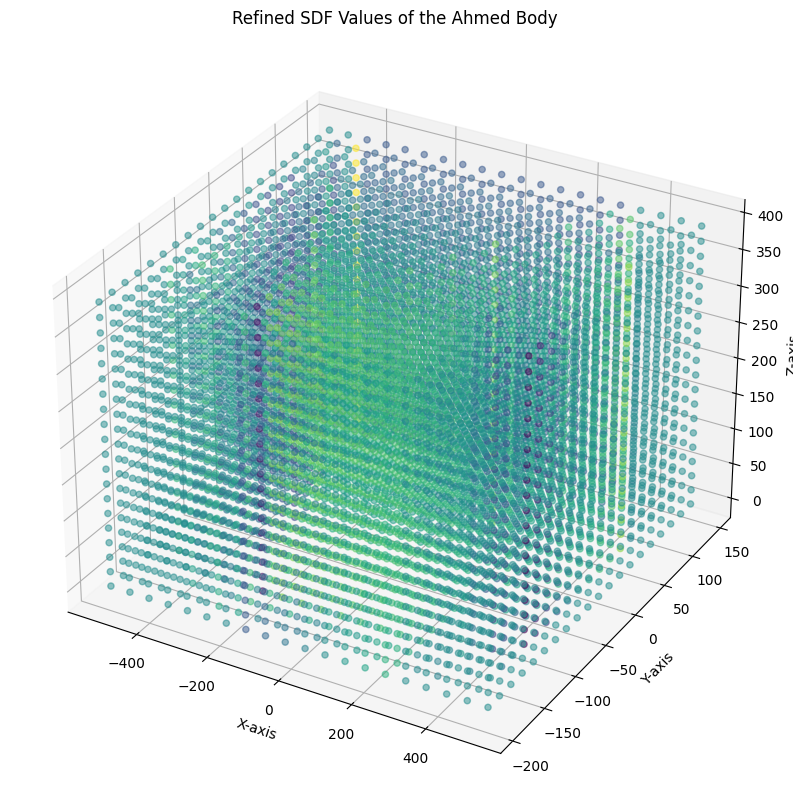

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from scipy.spatial import Delaunay

# Step 1: Load the STL file of the Ahmed Body and extract the vertices
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Convert vertices to a PyTorch tensor
vertices_tensor = torch.tensor(vertices, dtype=torch.float32)

# Step 2: Create dummy SDF values (placeholders) for the vertices
sdf_values = torch.randn(vertices_tensor.shape[0])  # Random SDF values for now

# Step 3: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 4: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 5: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 6: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 2000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Step 7: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of vertices for training
    indices = torch.randperm(vertices_tensor.size(0))[:batch_size]
    sampled_vertices = vertices_tensor[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((sampled_vertices, sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all vertices to compute refined SDF values
    mlp_input = torch.cat((vertices_tensor, sdf_values.unsqueeze(1)), dim=1)
    features = mlp(mlp_input)
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 9: Create a 3D grid for visualization
x_min, x_max = vertices[:, 0].min(), vertices[:, 0].max()
y_min, y_max = vertices[:, 1].min(), vertices[:, 1].max()
z_min, z_max = vertices[:, 2].min(), vertices[:, 2].max()

x = np.linspace(x_min, x_max, 20)  # Change grid resolution as needed
y = np.linspace(y_min, y_max, 20)
z = np.linspace(z_min, z_max, 20)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Compute SDF for the grid points using refined SDF values (interpolation)
tri = Delaunay(vertices[:, :2])  # 2D Delaunay triangulation for XY plane
grid_sdf_values = np.zeros(xx.shape)

for i in range(grid_points.shape[0]):
    simplex = tri.find_simplex(grid_points[i, :2])  # Only use x, y for simplex
    if simplex >= 0:  # If the point is inside a triangle
        vertices_indices = tri.simplices[simplex]
        # Barycentric coordinates
        bary = tri.transform[simplex, :2].dot(grid_points[i, :2] - tri.transform[simplex, 2])
        if np.all(bary >= 0):
            # Interpolate SDF values
            grid_sdf_values.ravel()[i] = (refined_sdf_values[vertices_indices] *
                                           (bary[0], bary[1], 1 - bary.sum())).sum()  # Corrected interpolation

# Reshape for plotting
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 10: Visualization of the refined SDF using 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Create a scatter plot of the SDF values
ax.scatter(xx, yy, zz, c=grid_sdf_values.ravel(), cmap='viridis', alpha=0.5)
ax.set_title('Refined SDF Values of the Ahmed Body')
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')

plt.show()


Number of vertices: 5359
Epoch 0, Loss: 959.442138671875
Epoch 100, Loss: 0.9284235239028931
Epoch 200, Loss: 0.9669925570487976
Epoch 300, Loss: 0.9935538172721863
Epoch 400, Loss: 0.9964162111282349
Epoch 500, Loss: 0.9688242673873901
Epoch 600, Loss: 1.0179431438446045
Epoch 700, Loss: 1.004964828491211
Epoch 800, Loss: 0.9704460501670837
Epoch 900, Loss: 0.9627999663352966


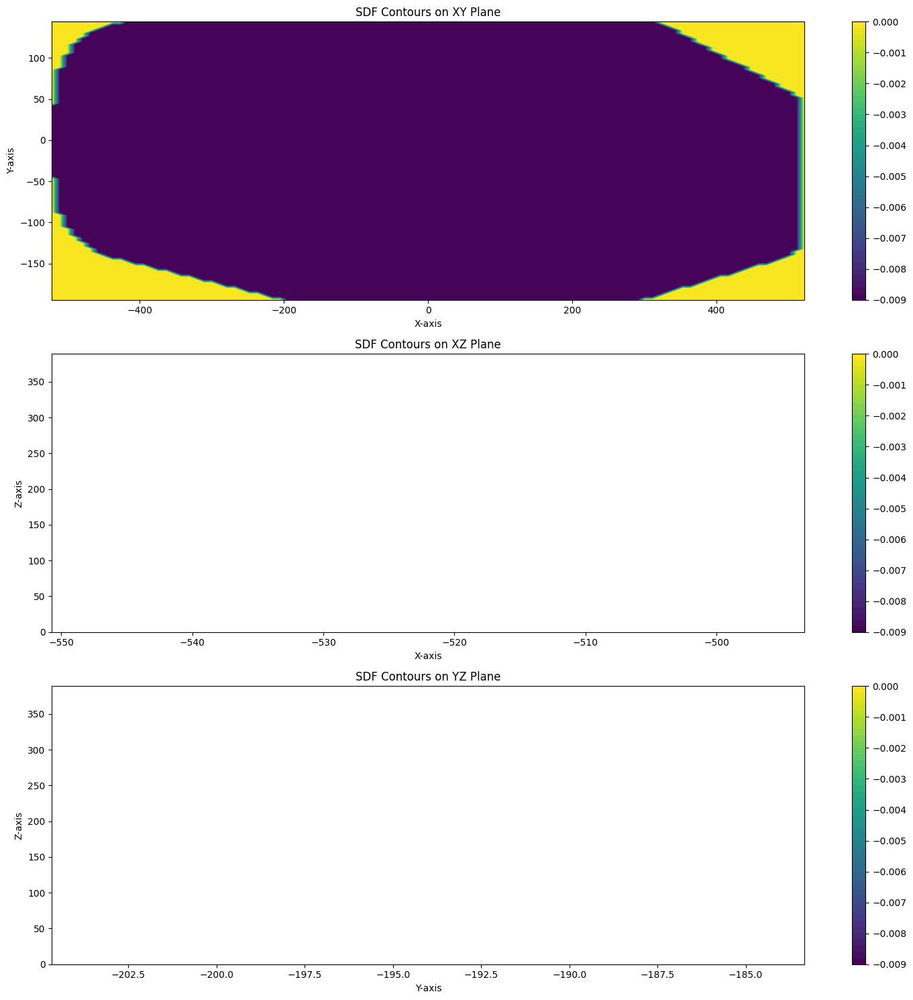

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from scipy.spatial import Delaunay

# Step 1: Load the STL file of the Ahmed Body and extract the vertices
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Convert vertices to a PyTorch tensor
vertices_tensor = torch.tensor(vertices, dtype=torch.float32)

# Step 2: Create dummy SDF values (placeholders) for the vertices
sdf_values = torch.randn(vertices_tensor.shape[0])  # Random SDF values for now

# Step 3: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 4: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 5: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 6: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 1000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Step 7: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of vertices for training
    indices = torch.randperm(vertices_tensor.size(0))[:batch_size]
    sampled_vertices = vertices_tensor[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((sampled_vertices, sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all vertices to compute refined SDF values
    mlp_input = torch.cat((vertices_tensor, sdf_values.unsqueeze(1)), dim=1)
    features = mlp(mlp_input)
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 9: Create a grid for visualization
x_min, x_max = vertices[:, 0].min(), vertices[:, 0].max()
y_min, y_max = vertices[:, 1].min(), vertices[:, 1].max()
z_min, z_max = vertices[:, 2].min(), vertices[:, 2].max()

x = np.linspace(x_min, x_max, 100)  # Adjust grid resolution
y = np.linspace(y_min, y_max, 100)
z = np.linspace(z_min, z_max, 100)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Compute SDF for the grid points using refined SDF values (interpolation)
tri = Delaunay(vertices[:, :2])  # 2D Delaunay triangulation for XY plane
grid_sdf_values = np.zeros(xx.shape)

for i in range(grid_points.shape[0]):
    simplex = tri.find_simplex(grid_points[i, :2])  # Only use x, y for simplex
    if simplex >= 0:  # If the point is inside a triangle
        vertices_indices = tri.simplices[simplex]
        # Barycentric coordinates
        bary = tri.transform[simplex, :2].dot(grid_points[i, :2] - tri.transform[simplex, 2])
        if np.all(bary >= 0):
            # Interpolate SDF values
            grid_sdf_values.ravel()[i] = (refined_sdf_values[vertices_indices] *
                                           (bary[0], bary[1], 1 - bary.sum())).sum()  # Corrected interpolation

# Reshape for plotting
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 10: Plotting SDF contours and projections
plt.figure(figsize=(15, 15))

# XY Plane
plt.subplot(3, 1, 1)
contour_xy = plt.contourf(xx[:, :, 0], yy[:, :, 0], grid_sdf_values[:, :, 0], levels=50, cmap='viridis')
plt.colorbar(contour_xy)
plt.title('SDF Contours on XY Plane')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')

# XZ Plane
plt.subplot(3, 1, 2)
contour_xz = plt.contourf(xx[:, 0, :], zz[:, 0, :], grid_sdf_values[:, 0, :], levels=50, cmap='viridis')
plt.colorbar(contour_xz)
plt.title('SDF Contours on XZ Plane')
plt.xlabel('X-axis')
plt.ylabel('Z-axis')

# YZ Plane
plt.subplot(3, 1, 3)
contour_yz = plt.contourf(yy[0, :, :], zz[0, :, :], grid_sdf_values[0, :, :], levels=50, cmap='viridis')
plt.colorbar(contour_yz)
plt.title('SDF Contours on YZ Plane')
plt.xlabel('Y-axis')
plt.ylabel('Z-axis')

plt.tight_layout()
plt.show()


Number of vertices: 5359
Epoch 0, Loss: 1560.2197265625
Epoch 100, Loss: 1.0147619247436523
Epoch 200, Loss: 0.999485969543457
Epoch 300, Loss: 0.9664832353591919
Epoch 400, Loss: 1.0295830965042114
Epoch 500, Loss: 1.0052196979522705
Epoch 600, Loss: 0.9261740446090698
Epoch 700, Loss: 1.006937861442566
Epoch 800, Loss: 0.9698879718780518
Epoch 900, Loss: 1.0059441328048706


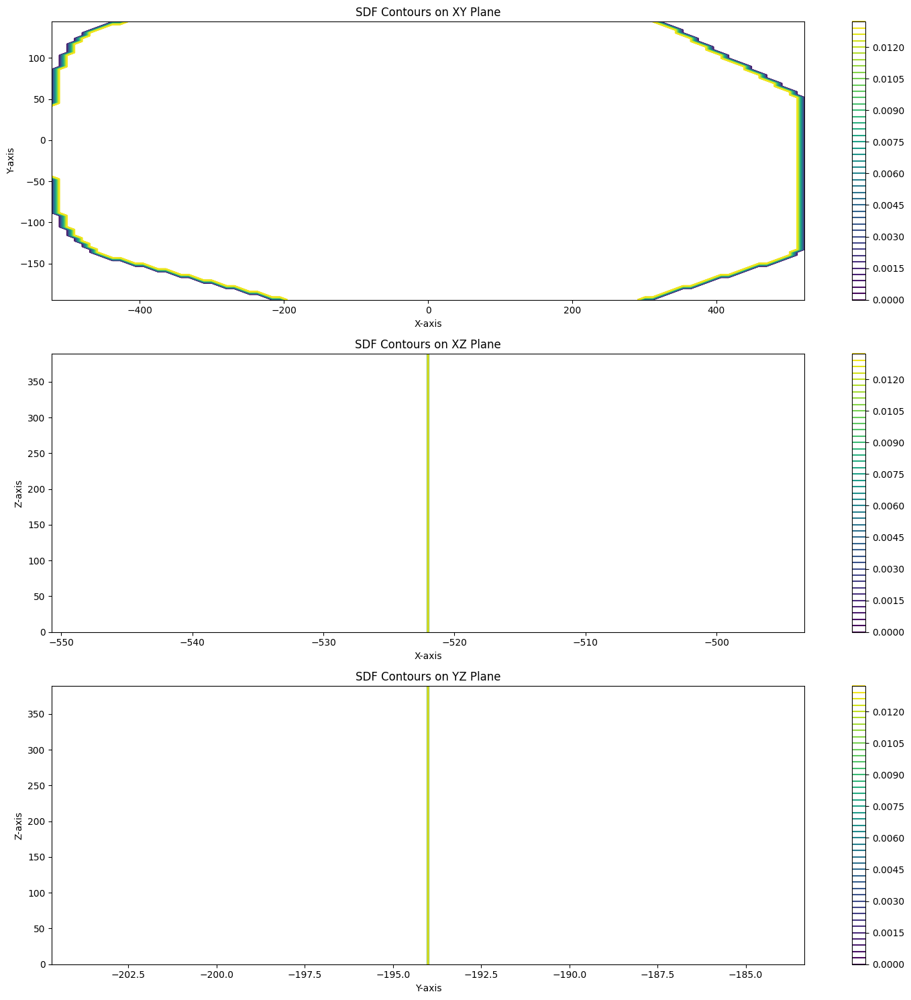

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from scipy.spatial import Delaunay

# Step 1: Load the STL file of the Ahmed Body and extract the vertices
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Convert vertices to a PyTorch tensor
vertices_tensor = torch.tensor(vertices, dtype=torch.float32)

# Step 2: Create dummy SDF values (placeholders) for the vertices
sdf_values = torch.randn(vertices_tensor.shape[0])  # Random SDF values for now

# Step 3: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 4: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 5: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 6: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 1000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Step 7: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of vertices for training
    indices = torch.randperm(vertices_tensor.size(0))[:batch_size]
    sampled_vertices = vertices_tensor[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((sampled_vertices, sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all vertices to compute refined SDF values
    mlp_input = torch.cat((vertices_tensor, sdf_values.unsqueeze(1)), dim=1)
    features = mlp(mlp_input)
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 9: Create a grid for visualization
x_min, x_max = vertices[:, 0].min(), vertices[:, 0].max()
y_min, y_max = vertices[:, 1].min(), vertices[:, 1].max()
z_min, z_max = vertices[:, 2].min(), vertices[:, 2].max()

x = np.linspace(x_min, x_max, 100)  # Adjust grid resolution
y = np.linspace(y_min, y_max, 100)
z = np.linspace(z_min, z_max, 100)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Compute SDF for the grid points using refined SDF values (interpolation)
tri = Delaunay(vertices[:, :2])  # 2D Delaunay triangulation for XY plane
grid_sdf_values = np.zeros(xx.shape)

for i in range(grid_points.shape[0]):
    simplex = tri.find_simplex(grid_points[i, :2])  # Only use x, y for simplex
    if simplex >= 0:  # If the point is inside a triangle
        vertices_indices = tri.simplices[simplex]
        # Barycentric coordinates
        bary = tri.transform[simplex, :2].dot(grid_points[i, :2] - tri.transform[simplex, 2])
        if np.all(bary >= 0):
            # Interpolate SDF values
            grid_sdf_values.ravel()[i] = (refined_sdf_values[vertices_indices] @ (bary[0], bary[1], 1 - bary.sum())).sum()  # Corrected interpolation

# Reshape for plotting
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 10: Plotting SDF contours and projections
plt.figure(figsize=(15, 15))

# XY Plane
plt.subplot(3, 1, 1)
contour_xy = plt.contour(xx[:, :, 0], yy[:, :, 0], grid_sdf_values[:, :, 0], levels=50, cmap='viridis')
plt.colorbar(contour_xy)
plt.title('SDF Contours on XY Plane')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')

# XZ Plane
plt.subplot(3, 1, 2)
contour_xz = plt.contour(xx[:, 0, :], zz[:, 0, :], grid_sdf_values[:, 0, :], levels=50, cmap='viridis')
plt.colorbar(contour_xz)
plt.title('SDF Contours on XZ Plane')
plt.xlabel('X-axis')
plt.ylabel('Z-axis')

# YZ Plane
plt.subplot(3, 1, 3)
contour_yz = plt.contour(yy[0, :, :], zz[0, :, :], grid_sdf_values[0, :, :], levels=50, cmap='viridis')
plt.colorbar(contour_yz)
plt.title('SDF Contours on YZ Plane')
plt.xlabel('Y-axis')
plt.ylabel('Z-axis')

plt.tight_layout()
plt.show()


Number of vertices: 5359
Epoch 0, Loss: 374.93951416015625
Epoch 100, Loss: 0.7965614795684814
Epoch 200, Loss: 0.5033977031707764
Epoch 300, Loss: 0.46032702922821045
Epoch 400, Loss: 0.3656942844390869
Epoch 500, Loss: 0.3705415427684784
Epoch 600, Loss: 0.5361447334289551
Epoch 700, Loss: 0.8639393448829651
Epoch 800, Loss: 0.5490550398826599
Epoch 900, Loss: 0.5439574122428894


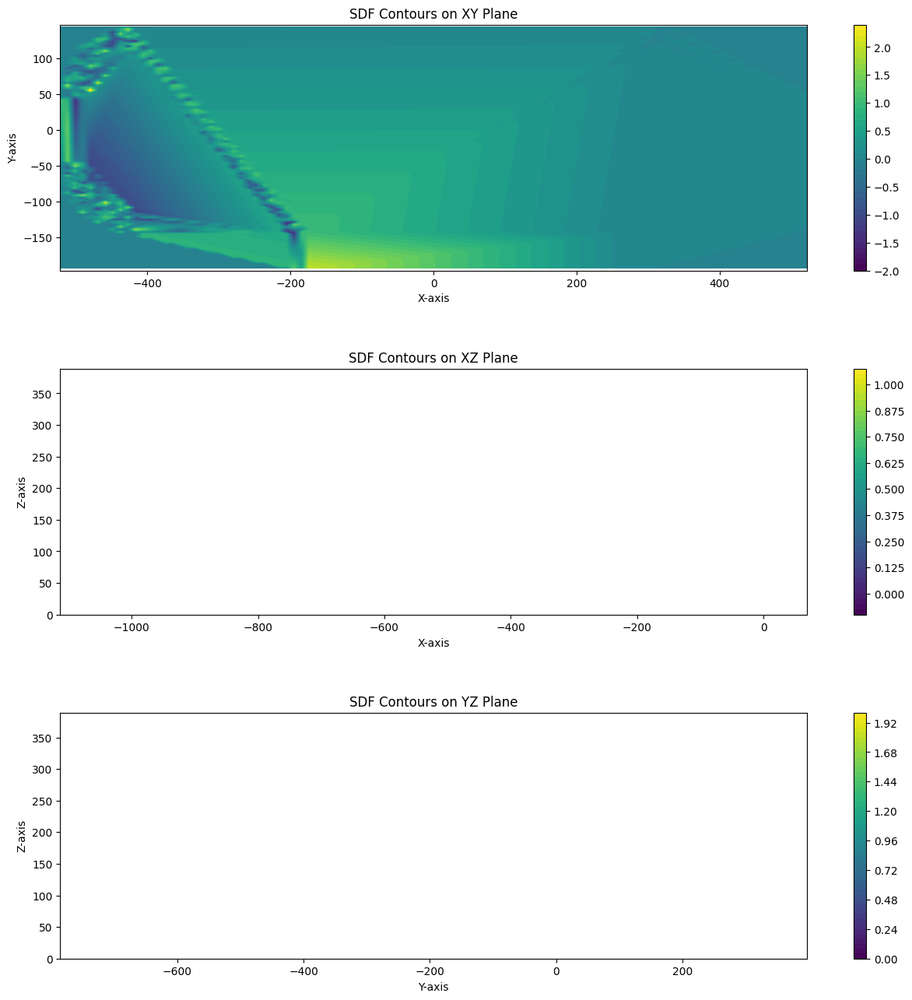

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from scipy.spatial import Delaunay

# Step 1: Load the STL file of the Ahmed Body and extract the vertices
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data)
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Convert vertices to a PyTorch tensor
vertices_tensor = torch.tensor(vertices, dtype=torch.float32)

# Step 2: Create dummy SDF values (placeholders) for the vertices
sdf_values = torch.randn(vertices_tensor.shape[0])  # Random SDF values for now

# Step 3: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 4: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 5: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 6: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.005)

# Number of training epochs
epochs = 1000
t = torch.linspace(0, 1, 10)
batch_size = 2000  # Define a batch size

# Step 7: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of vertices for training
    indices = torch.randperm(vertices_tensor.size(0))[:batch_size]
    sampled_vertices = vertices_tensor[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((sampled_vertices, sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 8: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all vertices to compute refined SDF values
    mlp_input = torch.cat((vertices_tensor, sdf_values.unsqueeze(1)), dim=1)
    features = mlp(mlp_input)
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 9: Create a grid for visualization
x_min, x_max = vertices[:, 0].min(), vertices[:, 0].max()
y_min, y_max = vertices[:, 1].min(), vertices[:, 1].max()
z_min, z_max = vertices[:, 2].min(), vertices[:, 2].max()

x = np.linspace(x_min, x_max, 100)  # Adjust grid resolution
y = np.linspace(y_min, y_max, 100)
z = np.linspace(z_min, z_max, 100)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Compute SDF for the grid points using refined SDF values (interpolation)
tri = Delaunay(vertices[:, :2])  # 2D Delaunay triangulation for XY plane
grid_sdf_values = np.zeros(xx.shape)

for i in range(grid_points.shape[0]):
    simplex = tri.find_simplex(grid_points[i, :2])  # Only use x, y for simplex
    if simplex >= 0:  # If the point is inside a triangle
        vertices_indices = tri.simplices[simplex]
        # Barycentric coordinates
        bary = tri.transform[simplex, :2].dot(grid_points[i, :2] - tri.transform[simplex, 2])
        if np.all(bary >= 0):
            # Interpolate SDF values
            grid_sdf_values.ravel()[i] = (refined_sdf_values[vertices_indices] @ (bary[0], bary[1], 1 - bary.sum())).sum()  # Corrected interpolation

# Reshape for plotting
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 10: Plotting SDF contours and projections with padding
plt.figure(figsize=(15, 15))

# XY Plane
plt.subplot(3, 1, 1)
contour_xy = plt.contourf(xx[:, :, 0], yy[:, :, 0], grid_sdf_values[:, :, 0], levels=50, cmap='viridis')
plt.colorbar(contour_xy)
plt.title('SDF Contours on XY Plane')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# XZ Plane
plt.subplot(3, 1, 2)
contour_xz = plt.contourf(xx[:, 0, :], zz[:, 0, :], grid_sdf_values[:, 0, :], levels=50, cmap='viridis')
plt.colorbar(contour_xz)
plt.title('SDF Contours on XZ Plane')
plt.xlabel('X-axis')
plt.ylabel('Z-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# YZ Plane
plt.subplot(3, 1, 3)
contour_yz = plt.contourf(yy[0, :, :], zz[0, :, :], grid_sdf_values[0, :, :], levels=50, cmap='viridis')
plt.colorbar(contour_yz)
plt.title('SDF Contours on YZ Plane')
plt.xlabel('Y-axis')
plt.ylabel('Z-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# Adjust layout to add white space around the plots
plt.subplots_adjust(hspace=0.4, left=0.1, right=0.9, top=0.9, bottom=0.1)
plt.show()


Number of vertices: 5359
Number of faces: 10714
Epoch 0, Loss: 22995.259765625
Epoch 100, Loss: 10630.4814453125
Epoch 200, Loss: 4525.357421875
Epoch 300, Loss: 372.4831848144531
Epoch 400, Loss: 29.296844482421875
Epoch 500, Loss: 13.31791877746582
Epoch 600, Loss: 8.325644493103027
Epoch 700, Loss: 5.404040813446045
Epoch 800, Loss: 4.839646816253662
Epoch 900, Loss: 4.1001152992248535
Epoch 1000, Loss: 3.536909580230713
Epoch 1100, Loss: 3.0912234783172607
Epoch 1200, Loss: 3.8848471641540527
Epoch 1300, Loss: 2.630875825881958
Epoch 1400, Loss: 2.696971893310547
Epoch 1500, Loss: 2.4678146839141846
Epoch 1600, Loss: 2.12483286857605
Epoch 1700, Loss: 1.9102163314819336
Epoch 1800, Loss: 1.8043612241744995
Epoch 1900, Loss: 1.515325665473938
Epoch 2000, Loss: 1.633407711982727
Epoch 2100, Loss: 1.6072036027908325
Epoch 2200, Loss: 1.413130521774292
Epoch 2300, Loss: 1.4646847248077393
Epoch 2400, Loss: 1.4724397659301758
Epoch 2500, Loss: 1.2941161394119263
Epoch 2600, Loss: 1.2915

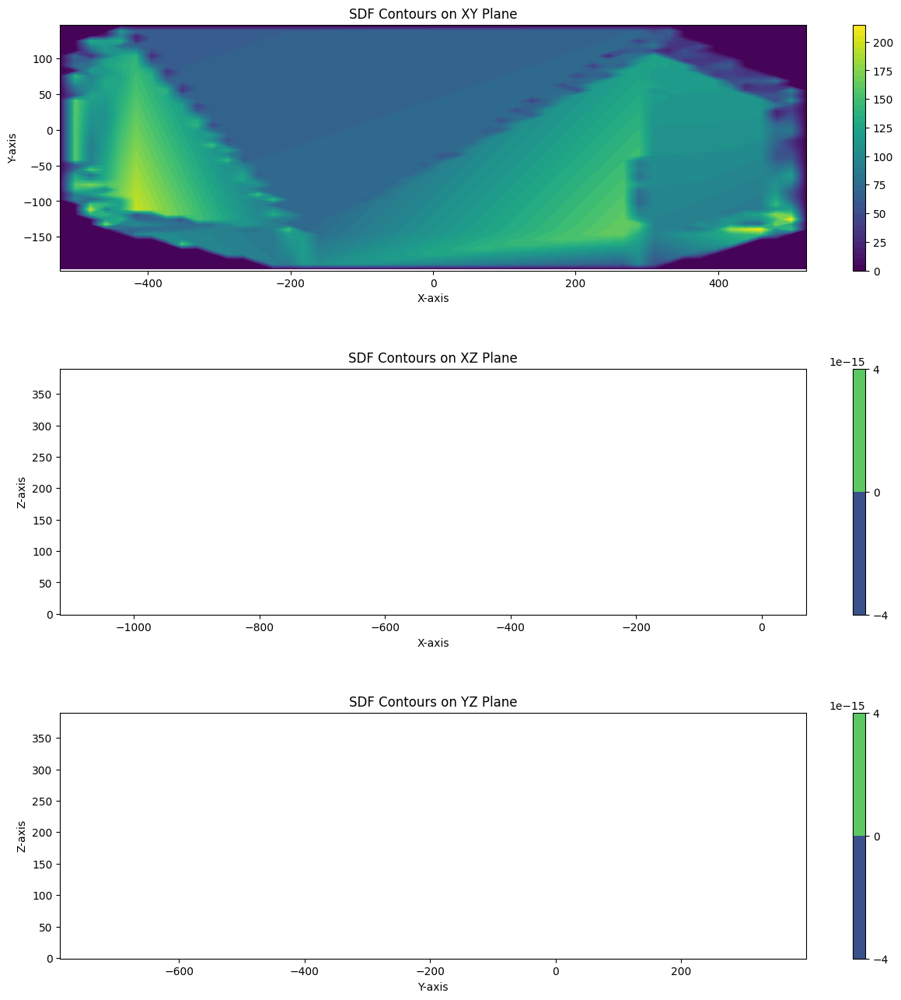

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial import cKDTree

# Step 1: Load the STL file of the Ahmed Body and extract the vertices and faces
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices and faces
vertices = mesh.vertices
faces = mesh.faces
print(f"Number of vertices: {len(vertices)}")
print(f"Number of faces: {len(faces)}")

# Step 2: Create a 3D grid for SDF initialization
grid_resolution = 50  # Resolution of the grid
x_min, x_max = vertices[:, 0].min() - 1, vertices[:, 0].max() + 1
y_min, y_max = vertices[:, 1].min() - 1, vertices[:, 1].max() + 1
z_min, z_max = vertices[:, 2].min() - 1, vertices[:, 2].max() + 1

# Create a 3D grid of points
x = np.linspace(x_min, x_max, grid_resolution)
y = np.linspace(y_min, y_max, grid_resolution)
z = np.linspace(z_min, z_max, grid_resolution)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Step 3: Use KD-Tree for fast nearest neighbor search
tree = cKDTree(vertices)

# Step 4: Compute the SDF for each grid point
sdf_values = tree.query(grid_points)[0]  # Get the distances to the nearest surface points
sdf_values = torch.tensor(sdf_values, dtype=torch.float32)  # Convert to PyTorch tensor

# Step 5: Define the MLP network for feature extraction
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 6: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 7: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 8: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.0001)

# Number of training epochs
epochs = 18000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# Step 9: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of grid points for training
    indices = torch.randperm(grid_points.shape[0])[:batch_size]
    sampled_points = grid_points[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((torch.tensor(sampled_points, dtype=torch.float32), sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 10: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all grid points to compute refined SDF values
    features = mlp(torch.cat((torch.tensor(grid_points, dtype=torch.float32), sdf_values.unsqueeze(1)), dim=1))
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 11: Create a grid for visualization
grid_sdf_values = np.zeros(xx.shape)

# Step 12: Compute SDF for the grid points using refined SDF values (interpolation)
tri = Delaunay(vertices[:, :2])  # 2D Delaunay triangulation for XY plane
for i in range(grid_points.shape[0]):
    simplex = tri.find_simplex(grid_points[i, :2])  # Only use x, y for simplex
    if simplex >= 0:  # If the point is inside a triangle
        vertices_indices = tri.simplices[simplex]
        # Barycentric coordinates
        bary = tri.transform[simplex, :2].dot(grid_points[i, :2] - tri.transform[simplex, 2])
        if np.all(bary >= 0):
            # Interpolate SDF values
            grid_sdf_values.ravel()[i] = (refined_sdf_values[vertices_indices] @ (bary[0], bary[1], 1 - bary.sum())).sum()  # Corrected interpolation

# Reshape for plotting
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 13: Plotting SDF contours and projections with padding
plt.figure(figsize=(15, 15))

# XY Plane
plt.subplot(3, 1, 1)
contour_xy = plt.contourf(xx[:, :, 0], yy[:, :, 0], grid_sdf_values[:, :, 0], levels=50, cmap='viridis')
plt.colorbar(contour_xy)
plt.title('SDF Contours on XY Plane')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# XZ Plane
plt.subplot(3, 1, 2)
contour_xz = plt.contourf(xx[:, 0, :], zz[:, 0, :], grid_sdf_values[:, 0, :], levels=50, cmap='viridis')
plt.colorbar(contour_xz)
plt.title('SDF Contours on XZ Plane')
plt.xlabel('X-axis')
plt.ylabel('Z-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# YZ Plane
plt.subplot(3, 1, 3)
contour_yz = plt.contourf(yy[0, :, :], zz[0, :, :], grid_sdf_values[0, :, :], levels=50, cmap='viridis')
plt.colorbar(contour_yz)
plt.title('SDF Contours on YZ Plane')
plt.xlabel('Y-axis')
plt.ylabel('Z-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# Adjust layout to add white space around the plots
plt.subplots_adjust(hspace=0.4, left=0.1, right=0.9, top=0.9, bottom=0.1)
plt.show()


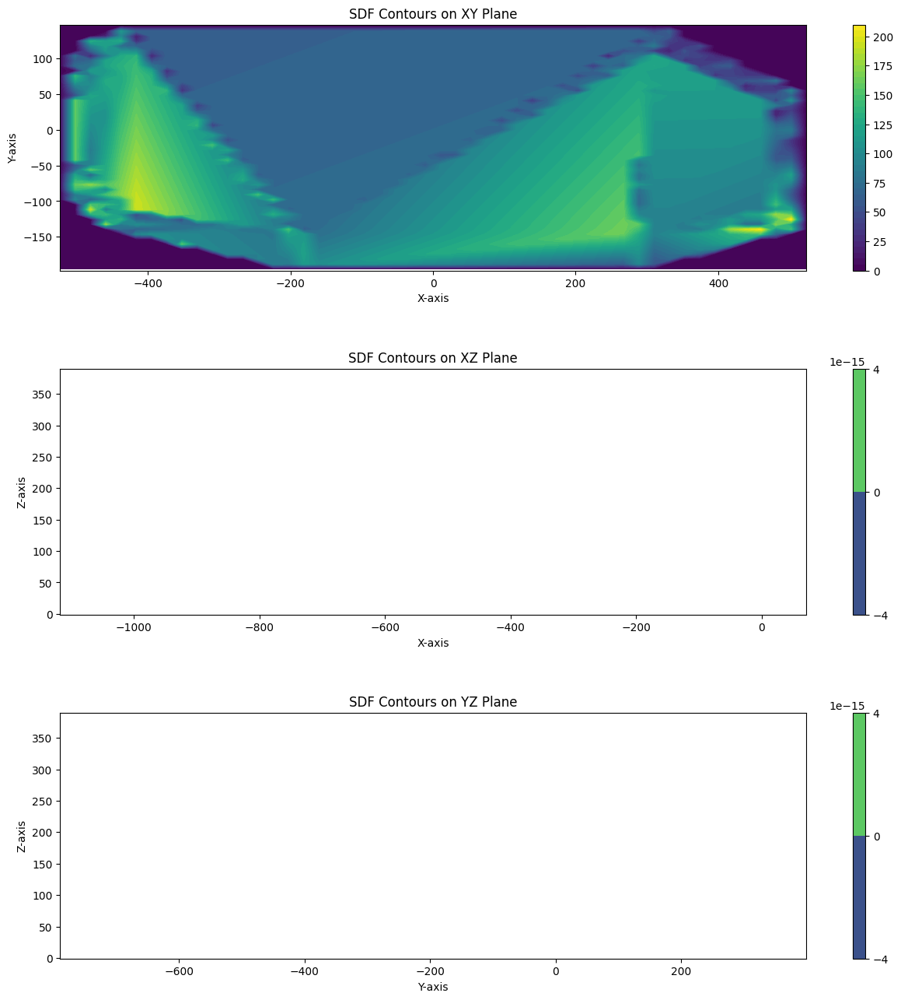

In [ ]:
grid_sdf_values = grid_sdf_values.reshape(xx.shape)

# Step 13: Plotting SDF contours and projections with padding
plt.figure(figsize=(15, 15))

# XY Plane
plt.subplot(3, 1, 1)
contour_xy = plt.contourf(xx[:, :, 0], yy[:, :, 0], grid_sdf_values[:, :, 0], levels=50, cmap='viridis')
plt.colorbar(contour_xy)
plt.title('SDF Contours on XY Plane')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# XZ Plane
plt.subplot(3, 1, 2)
contour_xz = plt.contourf(xx[:, 0, :], zz[:, 0, :], grid_sdf_values[:, 0, :], levels=50, cmap='viridis')
plt.colorbar(contour_xz)
plt.title('SDF Contours on XZ Plane')
plt.xlabel('X-axis')
plt.ylabel('Z-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# YZ Plane
plt.subplot(3, 1, 3)
contour_yz = plt.contourf(yy[0, :, :], zz[0, :, :], grid_sdf_values[0, :, :], levels=50, cmap='viridis')
plt.colorbar(contour_yz)
plt.title('SDF Contours on YZ Plane')
plt.xlabel('Y-axis')
plt.ylabel('Z-axis')
plt.axis('equal')  # Equal aspect ratio for better visualization
plt.grid(False)

# Adjust layout to add white space around the plots
plt.subplots_adjust(hspace=0.4, left=0.1, right=0.9, top=0.9, bottom=0.1)
plt.show()

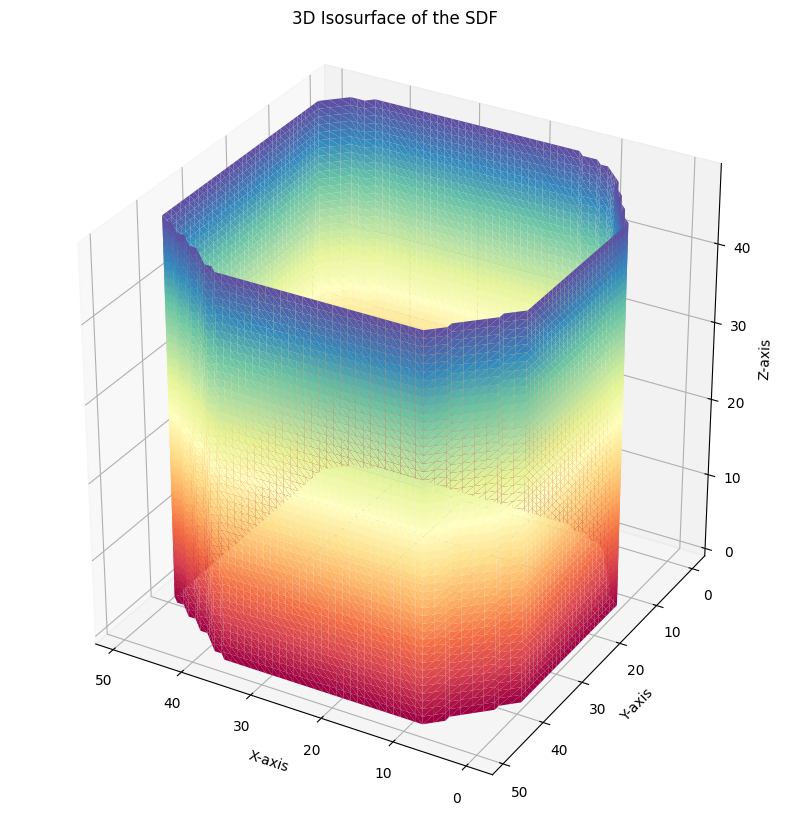

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from skimage import measure

# Step 1: Compute the isosurface from the SDF values using marching cubes
verts, faces, normals, values = measure.marching_cubes(grid_sdf_values, level=0)

# Step 2: Plot the isosurface using Matplotlib's 3D plot
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

# Plot the mesh using trisurf
ax.plot_trisurf(verts[:, 0], verts[:, 1], faces, verts[:, 2],
                cmap='Spectral', lw=1)

# Add labels and set the aspect ratio
ax.set_title('3D Isosurface of the SDF')
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')
ax.view_init(elev=30, azim=120)  # Adjust view angle
ax.set_box_aspect([1, 1, 1])  # Equal aspect ratio

plt.show()


In [ ]:
import plotly.graph_objects as go
import numpy as np

# Step 1: Create an isosurface plot using Plotly's go.Isosurface
fig = go.Figure(data=go.Isosurface(
    x=xx.flatten(),  # X-coordinates of the grid
    y=yy.flatten(),  # Y-coordinates of the grid
    z=zz.flatten(),  # Z-coordinates of the grid
    value=grid_sdf_values.flatten(),  # The SDF values at each grid point
    isomin=-1,  # Minimum value for the isosurface
    isomax=1,   # Maximum value for the isosurface
    surface_count=5,  # Number of isosurfaces to plot between isomin and isomax
    colorscale='Viridis',  # Color scheme for the surface
    caps=dict(x_show=False, y_show=False)  # Hide caps at the boundaries
))

# Step 2: Update layout to improve appearance
fig.update_layout(
    title="3D SDF Isosurface",
    scene=dict(
        xaxis_title='X-axis',
        yaxis_title='Y-axis',
        zaxis_title='Z-axis',
        aspectmode='cube'  # Equal aspect ratio for all axes
    )
)

# Step 3: Show the plot
fig.show()



In [ ]:
import numpy as np
from skimage import measure  # For marching cubes
import trimesh
import plotly.graph_objects as go

# Assuming the following grid and SDF values are precomputed:
# - xx, yy, zz: 3D grids (created using np.meshgrid or similar)
# - grid_sdf_values: SDF values (3D numpy array) for each point in the grid

# Example setup for xx, yy, zz grids and grid_sdf_values (if not already available):
# Replace this with your actual grid setup.
x = np.linspace(-1, 1, 50)
y = np.linspace(-1, 1, 50)
z = np.linspace(-1, 1, 50)
xx, yy, zz = np.meshgrid(x, y, z)
# Generate dummy SDF values for demonstration purposes
grid_sdf_values = np.sqrt(xx**2 + yy**2 + zz**2) - 0.5  # Sphere SDF example

# Step 1: Use Marching Cubes to extract the mesh from the SDF values
# The threshold (0) indicates the surface we want to extract
vertices, faces, normals, _ = measure.marching_cubes(grid_sdf_values, level=0, spacing=(x[1] - x[0], y[1] - y[0], z[1] - z[0]))

# Step 2: Create a Trimesh object from the vertices and faces
mesh = trimesh.Trimesh(vertices=vertices, faces=faces)

# Step 3: Export the mesh to an STL file
stl_filename = 'sdf_isosurface.stl'
mesh.export(stl_filename)
print(f"STL file saved as: {stl_filename}")

# Step 4: Visualize the mesh using Plotly (optional step to verify the mesh)
x_coords, y_coords, z_coords = vertices[:, 0], vertices[:, 1], vertices[:, 2]
i, j, k = faces[:, 0], faces[:, 1], faces[:, 2]

# Create a 3D Mesh plot
fig = go.Figure(data=[go.Mesh3d(
    x=x_coords, y=y_coords, z=z_coords,
    i=i, j=j, k=k,
    color='lightblue', opacity=0.5
)])

fig.update_layout(
    title="3D Mesh of SDF Isosurface",
    scene=dict(
        xaxis_title='X-axis',
        yaxis_title='Y-axis',
        zaxis_title='Z-axis',
        aspectmode='data'  # Keeps aspect ratio correct
    ),
    margin=dict(l=0, r=0, t=50, b=0)  # Adjust margins for better display
)

# Step 5: Show the plot
fig.show()


STL file saved as: sdf_isosurface.stl


Number of vertices: 5359
Number of faces: 10714
Epoch 0, Loss: 21018.427734375
Epoch 100, Loss: 10237.224609375
Epoch 200, Loss: 3530.892333984375
Epoch 300, Loss: 682.2301025390625
Epoch 400, Loss: 115.50279998779297
Epoch 500, Loss: 33.41899490356445
Epoch 600, Loss: 15.439814567565918
Epoch 700, Loss: 9.300464630126953
Epoch 800, Loss: 6.598758220672607
Epoch 900, Loss: 5.911952972412109
Epoch 1000, Loss: 4.3872761726379395
Epoch 1100, Loss: 4.152181148529053
Epoch 1200, Loss: 3.999094247817993
Epoch 1300, Loss: 3.13704776763916
Epoch 1400, Loss: 3.1430976390838623
Epoch 1500, Loss: 2.935176372528076
Epoch 1600, Loss: 2.7730531692504883
Epoch 1700, Loss: 2.221999406814575
Epoch 1800, Loss: 2.529850721359253
Epoch 1900, Loss: 1.8356366157531738


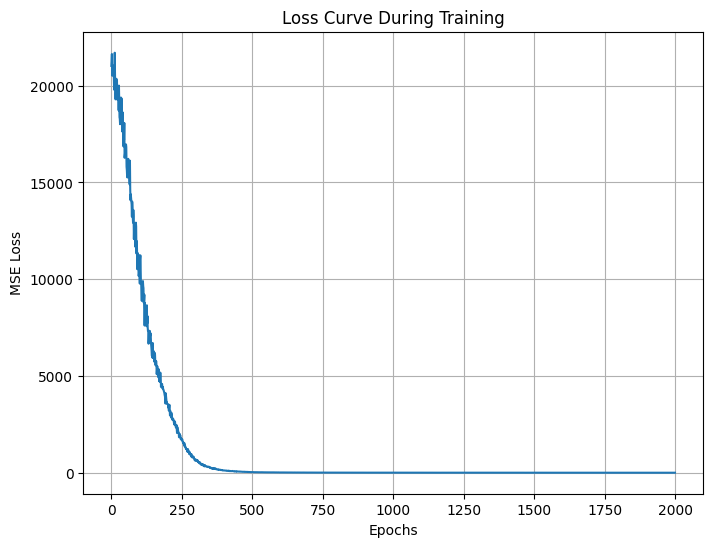

In [ ]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
import trimesh
import numpy as np
from scipy.spatial import cKDTree
from scipy.spatial import Delaunay
import plotly.graph_objects as go
import matplotlib.pyplot as plt

# Step 1: Load the STL file of the Ahmed Body and extract the vertices and faces
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices and faces
vertices = mesh.vertices
faces = mesh.faces
print(f"Number of vertices: {len(vertices)}")
print(f"Number of faces: {len(faces)}")

# Step 2: Create a 3D grid for SDF initialization
grid_resolution = 50  # Resolution of the grid
x_min, x_max = vertices[:, 0].min() - 1, vertices[:, 0].max() + 1
y_min, y_max = vertices[:, 1].min() - 1, vertices[:, 1].max() + 1
z_min, z_max = vertices[:, 2].min() - 1, vertices[:, 2].max() + 1

# Create a 3D grid of points
x = np.linspace(x_min, x_max, grid_resolution)
y = np.linspace(y_min, y_max, grid_resolution)
z = np.linspace(z_min, z_max, grid_resolution)
xx, yy, zz = np.meshgrid(x, y, z)
grid_points = np.vstack((xx.ravel(), yy.ravel(), zz.ravel())).T

# Step 3: Use KD-Tree for fast nearest neighbor search
tree = cKDTree(vertices)

# Step 4: Compute the SDF for each grid point
sdf_values = tree.query(grid_points)[0]  # Get the distances to the nearest surface points
sdf_values = torch.tensor(sdf_values, dtype=torch.float32)  # Convert to PyTorch tensor

# Step 5: Define the MLP network for feature extraction (with an additional hidden layer)
class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),  # First hidden layer
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),  # Second hidden layer
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),  # Third hidden layer (newly added)
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim)   # Output layer
        )

    def forward(self, x):
        return self.network(x)

# Initialize MLP (input is XYZ coordinates + SDF, so input_dim=4)
mlp = MLP(input_dim=4, hidden_dim=32, output_dim=64)

# Step 6: Define the ODE function for the Neural ODE
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, t, h):
        return self.linear(h)

# Initialize the ODE function
ode_func = ODEFunc(hidden_dim=64)

# Step 7: Neural ODE solver
def neural_ode(h0, t):
    return odeint(ode_func, h0, t)

# Step 8: Set up the loss function and optimizer
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(list(mlp.parameters()) + list(ode_func.parameters()), lr=0.0001)

# Number of training epochs
epochs = 2000
t = torch.linspace(0, 1, 10)
batch_size = 1000  # Define a batch size

# For plotting loss
loss_history = []

# Step 9: Training loop
for epoch in range(epochs):
    optimizer.zero_grad()

    # Randomly sample a subset of grid points for training
    indices = torch.randperm(grid_points.shape[0])[:batch_size]
    sampled_points = grid_points[indices]
    sampled_sdf_values = sdf_values[indices]

    # Concatenate XYZ + SDF as input to the MLP
    mlp_input = torch.cat((torch.tensor(sampled_points, dtype=torch.float32), sampled_sdf_values.unsqueeze(1)), dim=1)

    # Get features from MLP
    features = mlp(mlp_input)

    # Refine the features using Neural ODE
    refined_features = neural_ode(features, t)[-1]  # Use final time step's output

    # The predicted SDF is the first component of the refined features
    predicted_sdf = refined_features[:, 0]

    # Compute the loss between predicted SDF and actual SDF
    loss = loss_fn(predicted_sdf, sampled_sdf_values)

    # Backpropagate the loss and update weights
    loss.backward()
    torch.nn.utils.clip_grad_norm_(list(mlp.parameters()) + list(ode_func.parameters()), max_norm=1.0)
    optimizer.step()

    # Store the loss for plotting
    loss_history.append(loss.item())

    # Print loss every 100 epochs
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

# Step 10: Evaluation and visualization of the refined SDF after training
with torch.no_grad():
    # Process all grid points to compute refined SDF values
    features = mlp(torch.cat((torch.tensor(grid_points, dtype=torch.float32), sdf_values.unsqueeze(1)), dim=1))
    refined_features = neural_ode(features, t)[-1]
    refined_sdf_values = refined_features[:, 0].numpy()

# Step 11: 3D plot using Plotly
fig = go.Figure(data=[go.Isosurface(
    x=grid_points[:, 0], y=grid_points[:, 1], z=grid_points[:, 2],
    value=refined_sdf_values,
    isomin=0.0, isomax=1.0,
    surface_count=10,  # Number of isosurfaces
    colorscale='Viridis',
    caps=dict(x_show=False, y_show=False, z_show=False)
)])

fig.update_layout(scene=dict(aspectmode='data'),
                  title='Refined SDF Isosurface of Ahmed Body')
fig.show()

# Step 12: Loss curve visualization
plt.figure(figsize=(8, 6))
plt.plot(loss_history)
plt.title('Loss Curve During Training')
plt.xlabel('Epochs')
plt.ylabel('MSE Loss')
plt.grid(True)
plt.show()


In [ ]:
import numpy as np
import trimesh
import plotly.graph_objects as go
from scipy.spatial import cKDTree

# Step 1: Load the STL file using trimesh
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Step 2: Extract vertices (XYZ data) from the Ahmed body
vertices = mesh.vertices
print(f"Number of vertices: {len(vertices)}")

# Step 3: Assume refined SDF points are available (for demonstration purposes)
# Simulating random refined SDF points around the Ahmed body
# You would replace this with your actual SDF points
num_points = 10000000  # Total number of points to simulate
random_points = np.random.uniform(np.min(vertices, axis=0), np.max(vertices, axis=0), (num_points, 3))

# Step 4: Create a KDTree for fast nearest neighbor search
tree = cKDTree(vertices)

# Step 5: Query the nearest points on the Ahmed body for each random point
distances, indices = tree.query(random_points)

# Step 6: Define a threshold for filtering points close to the surface
threshold = 1.5  # Adjust this value as needed

# Step 7: Filter points based on the threshold
close_points = random_points[distances < threshold]
print(f"Number of points close to the surface: {len(close_points)}")

# Step 8: Create a 3D mesh plot using Plotly
mesh_plot = go.Mesh3d(
    x=vertices[:, 0],
    y=vertices[:, 1],
    z=vertices[:, 2],
    i=mesh.faces[:, 0],
    j=mesh.faces[:, 1],
    k=mesh.faces[:, 2],
    color='lightblue',
    opacity=0.5,
)

# Step 9: Create a scatter plot for the close points
scatter_plot = go.Scatter3d(
    x=close_points[:, 0],
    y=close_points[:, 1],
    z=close_points[:, 2],
    mode='markers',
    marker=dict(size=3, color='red'),  # Change the color and size as needed
    name='Points Close to Surface'
)

# Step 10: Create a figure and add both the mesh and scatter plot
fig = go.Figure(data=[mesh_plot, scatter_plot])

# Step 11: Set plot layout for better visuals
fig.update_layout(
    title="Points Close to the Surface of Ahmed Body",
    scene=dict(
        xaxis_title='X-axis',
        yaxis_title='Y-axis',
        zaxis_title='Z-axis',
        aspectmode='data'
    ),
    margin=dict(l=0, r=0, t=50, b=0),
)

# Step 12: Show the plot
fig.show()


Number of vertices: 5359
Number of points close to the surface: 4232


In [ ]:
import numpy as np
import trimesh
import plotly.graph_objects as go
from scipy.spatial import cKDTree
from scipy.interpolate import Rbf

# Load the STL file using trimesh
stl_filename = './ahmed_body/Ahmed-Body-CAD-Model-FetchCFD-STL-file.stl'
mesh = trimesh.load_mesh(stl_filename)

# Extract vertices (XYZ data) from the Ahmed body
vertices = mesh.vertices

# Simulate random refined SDF points around the Ahmed body (replace with actual SDF points)
num_points = 100000  # Total number of points to simulate
random_points = np.random.uniform(np.min(vertices, axis=0), np.max(vertices, axis=0), (num_points, 3))

# Create a KDTree for fast nearest neighbor search
tree = cKDTree(vertices)

# Query the nearest points on the Ahmed body for each random point
distances, indices = tree.query(random_points)

# Define a threshold for filtering points close to the surface
threshold = 1.5  # Adjust this value as needed

# Filter points based on the threshold
close_points = random_points[distances < threshold]

# Define the generalized transformation matrix
transformation_matrix = np.array([
    [0.2, 0.1, 1.05, 0.2],  # First row
    [0.0, 1.8, 0.1, -0.1], # Second row
    [0.5, 1.0, 0.1, 0.1],  # Third row
    [0.5, 0.5, 0.0, 1.6]   # Fourth row (homogeneous coordinate)
])

# Apply the transformation matrix to the control points
close_points_homogeneous = np.hstack((close_points, np.ones((close_points.shape[0], 1))))
transformed_points_homogeneous = np.dot(close_points_homogeneous, transformation_matrix.T)
transformed_points = transformed_points_homogeneous[:, :3]

# Apply RBF for deformation
rbf_x = Rbf(close_points[:, 0], close_points[:, 1], close_points[:, 2], transformed_points[:, 0], function='thin_plate')
rbf_y = Rbf(close_points[:, 0], close_points[:, 1], close_points[:, 2], transformed_points[:, 1], function='thin_plate')
rbf_z = Rbf(close_points[:, 0], close_points[:, 1], close_points[:, 2], transformed_points[:, 2], function='thin_plate')

# Deform the vertices of the Ahmed body
deformed_vertices = np.vstack((rbf_x(vertices[:, 0], vertices[:, 1], vertices[:, 2]),
                               rbf_y(vertices[:, 0], vertices[:, 1], vertices[:, 2]),
                               rbf_z(vertices[:, 0], vertices[:, 1], vertices[:, 2]))).T

# Create a new mesh with the deformed vertices
deformed_mesh = trimesh.Trimesh(vertices=deformed_vertices, faces=mesh.faces)

# Create a 3D mesh plot for the original Ahmed body
original_mesh_plot = go.Mesh3d(
    x=vertices[:, 0],
    y=vertices[:, 1],
    z=vertices[:, 2],
    i=mesh.faces[:, 0],
    j=mesh.faces[:, 1],
    k=mesh.faces[:, 2],
    color='lightblue',
    opacity=0.5,
    name='Original Ahmed Body'
)

# Create a 3D mesh plot for the deformed Ahmed body
deformed_mesh_plot = go.Mesh3d(
    x=deformed_vertices[:, 0],
    y=deformed_vertices[:, 1],
    z=deformed_vertices[:, 2],
    i=mesh.faces[:, 0],
    j=mesh.faces[:, 1],
    k=mesh.faces[:, 2],
    color='orange',
    opacity=0.5,
    name='Deformed Ahmed Body'
)

# Create a scatter plot for the refined SDF points
sdf_scatter_plot = go.Scatter3d(
    x=close_points[:, 0],
    y=close_points[:, 1],
    z=close_points[:, 2],
    mode='markers',
    marker=dict(size=3, color='red'),  # Change the color and size as needed
    name='Refined SDF Points'
)

# Create a figure and add all plots
fig = go.Figure(data=[original_mesh_plot, deformed_mesh_plot, sdf_scatter_plot])

# Set plot layout for better visuals
fig.update_layout(
    title="Original and Deformed Ahmed Body with Refined SDF Points",
    scene=dict(
        xaxis_title='X-axis',
        yaxis_title='Y-axis',
        zaxis_title='Z-axis',
        aspectmode='data'
    ),
    margin=dict(l=0, r=0, t=50, b=0),
)

# Show the plot
fig.show()


In [ ]:


# Step 13: 3D plot using Plotly to visualize layers of the refined SDF
# Setting the threshold to visualize layers close to the surface
thresholds = np.linspace(-0.1, 0.1, num=10)  # Define a range of thresholds around zero

# Create a figure for the isosurfaces
fig = go.Figure()

# Adding multiple isosurfaces for different thresholds
for i in range(len(thresholds) - 1):
    fig.add_trace(go.Isosurface(
        x=grid_points[:, 0],
        y=grid_points[:, 1],
        z=grid_points[:, 2],
        value=refined_sdf_values,
        isomin=thresholds[i],
        isomax=thresholds[i + 1],
        surface_count=1,  # Only one isosurface per threshold
        colorscale=[[0, 'rgba(0, 0, 0, 0)'], [1, f'rgba(0, 0, 255, {0.1 * (i + 1)})']],  # Gradually increasing opacity
        name=f'Layer {i + 1}',
        showscale=False,  # Hide scale for individual layers
        caps=dict(x_show=False, y_show=False, z_show=False)
    ))

fig.update_layout(scene=dict(aspectmode='data'),
                  title='Layer Visualization of Refined SDF Isosurface of Ahmed Body')
fig.show()


Buffered data was truncated after reaching the output size limit.

In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming `refined_sdf_values` contains the SDF values and `grid_points` contains the 3D coordinates.
# Step 1: Select points within a specific SDF layer (e.g., near zero)
# Adjust the thresholds to select the whole layer
lower_threshold = -0.1
upper_threshold = 0.1

# Select all points within the specified SDF layer
layer_points = grid_points[(refined_sdf_values >= lower_threshold) & (refined_sdf_values <= upper_threshold)]

# Optional: Visualize the layer points
fig = go.Figure()
fig.add_trace(go.Scatter3d(x=layer_points[:, 0], y=layer_points[:, 1], z=layer_points[:, 2],
                             mode='markers', marker=dict(size=2, color='green'), name='Layer Points'))

# Add isosurface of the refined SDF for reference
fig.add_trace(go.Isosurface(
    x=grid_points[:, 0],
    y=grid_points[:, 1],
    z=grid_points[:, 2],
    value=refined_sdf_values,
    isomin=0.0,
    isomax=1.0,
    surface_count=1,
    colorscale='Viridis',
    name='Refined SDF Isosurface'
))

fig.update_layout(title='Layer Points Visualization')
fig.show()

# Step 2: Create a transformation matrix
def create_transformation_matrix(scale, rotation, translation):
    # Scale matrix
    scale_matrix = np.diag([scale, scale, scale])

    # Rotation matrix (assuming rotation is given as angles in radians)
    rotation_matrix = np.array([
        [np.cos(rotation[2]) * np.cos(rotation[1]),
         np.cos(rotation[2]) * np.sin(rotation[1]) * np.sin(rotation[0]) - np.sin(rotation[2]) * np.cos(rotation[0]),
         np.cos(rotation[2]) * np.sin(rotation[1]) * np.cos(rotation[0]) + np.sin(rotation[2]) * np.sin(rotation[0])],

        [np.sin(rotation[2]) * np.cos(rotation[1]),
         np.sin(rotation[2]) * np.sin(rotation[1]) * np.sin(rotation[0]) + np.cos(rotation[2]) * np.cos(rotation[0]),
         np.sin(rotation[2]) * np.sin(rotation[1]) * np.cos(rotation[0]) - np.cos(rotation[2]) * np.sin(rotation[0])],

        [-np.sin(rotation[1]),
         np.cos(rotation[1]) * np.sin(rotation[0]),
         np.cos(rotation[1]) * np.cos(rotation[0])]
    ])

    # Translation vector
    translation_vector = np.array(translation)

    # Combine into a single transformation matrix
    transformation_matrix = np.eye(4)
    transformation_matrix[:3, :3] = rotation_matrix @ scale_matrix
    transformation_matrix[:3, 3] = translation_vector

    return transformation_matrix

# Example parameters for transformation
scale = 2.1  # Scale factor
rotation = np.array([np.pi / 20, 0, 0])  # Rotation in radians (pitch, yaw, roll)
translation = np.array([0, 0, 0.5])  # Translation vector

transformation_matrix = create_transformation_matrix(scale, rotation, translation)

# Step 3: Apply transformation to the layer points
def apply_transformation(points, transformation_matrix):
    # Add a column of ones to the points to use homogeneous coordinates
    points_homogeneous = np.hstack([points, np.ones((points.shape[0], 1))])

    # Apply the transformation
    transformed_points = points_homogeneous @ transformation_matrix.T

    return transformed_points[:, :3]  # Return only the 3D coordinates

# Apply transformation
transformed_layer_points = apply_transformation(layer_points, transformation_matrix)

# Optional: Visualize the transformed shape with the original layer points
fig = go.Figure()
fig.add_trace(go.Scatter3d(x=layer_points[:, 0], y=layer_points[:, 1], z=layer_points[:, 2],
                             mode='markers', marker=dict(size=2, color='green'), name='Original Layer Points'))

fig.add_trace(go.Scatter3d(x=transformed_layer_points[:, 0],
                             y=transformed_layer_points[:, 1],
                             z=transformed_layer_points[:, 2],
                             mode='markers', marker=dict(size=2, color='blue'), name='Transformed Layer Points'))

fig.update_layout(title='Layer Points Before and After Transformation')
fig.show()


In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from scipy.interpolate import Rbf, griddata

# Load the target car shape data from the CSV file
target_csv_filename = '/content/datasurfaceSurface20.csv'
target_data = pd.read_csv(target_csv_filename, header=None, skiprows=1)  # Skip header row
target_vertices = target_data.values.astype(np.float32)  # Convert to float32

# Assuming refined_sdf_values and grid_points are already defined from your SDF
# Example grid_points and refined_sdf_values (should be replaced by your actual data)
# grid_points = np.random.rand(10000, 3)  # 10000 random points in 3D
# refined_sdf_values = np.random.uniform(-1, 1, size=10000)  # Random SDF values

# Step 1: Select points within a specific SDF layer
lower_threshold = -0.1
upper_threshold = 0.1
layer_points = grid_points[(refined_sdf_values >= lower_threshold) & (refined_sdf_values <= upper_threshold)]

# Visualize the layer points
fig = go.Figure()
fig.add_trace(go.Scatter3d(x=layer_points[:, 0], y=layer_points[:, 1], z=layer_points[:, 2],
                             mode='markers', marker=dict(size=2, color='green'), name='Layer Points'))

# Add isosurface of the refined SDF for reference
fig.add_trace(go.Isosurface(
    x=grid_points[:, 0],
    y=grid_points[:, 1],
    z=grid_points[:, 2],
    value=refined_sdf_values,
    isomin=0.0,
    isomax=1.0,
    surface_count=1,
    colorscale='Viridis',
    name='Refined SDF Isosurface'
))

fig.update_layout(title='Layer Points Visualization')
fig.show()

# Create a transformation matrix
def create_transformation_matrix(scale, rotation, translation):
    # Scale matrix
    scale_matrix = np.diag([scale, scale, scale])

    # Rotation matrix
    rotation_matrix = np.array([
        [np.cos(rotation[2]) * np.cos(rotation[1]),
         np.cos(rotation[2]) * np.sin(rotation[1]) * np.sin(rotation[0]) - np.sin(rotation[2]) * np.cos(rotation[0]),
         np.cos(rotation[2]) * np.sin(rotation[1]) * np.cos(rotation[0]) + np.sin(rotation[2]) * np.sin(rotation[0])],

        [np.sin(rotation[2]) * np.cos(rotation[1]),
         np.sin(rotation[2]) * np.sin(rotation[1]) * np.sin(rotation[0]) + np.cos(rotation[2]) * np.cos(rotation[0]),
         np.sin(rotation[2]) * np.sin(rotation[1]) * np.cos(rotation[0]) - np.cos(rotation[2]) * np.sin(rotation[0])],

        [-np.sin(rotation[1]),
         np.cos(rotation[1]) * np.sin(rotation[0]),
         np.cos(rotation[1]) * np.cos(rotation[0])]
    ])

    # Translation vector
    translation_vector = np.array(translation)

    # Combine into a single transformation matrix
    transformation_matrix = np.eye(4)
    transformation_matrix[:3, :3] = rotation_matrix @ scale_matrix
    transformation_matrix[:3, 3] = translation_vector

    return transformation_matrix

# Example parameters for transformation
scale = 2.1  # Scale factor
rotation = np.array([np.pi / 20, 0, 0])  # Rotation in radians (pitch, yaw, roll)
translation = np.array([0, 0, 0.5])  # Translation vector

transformation_matrix = create_transformation_matrix(scale, rotation, translation)

# Apply transformation to the layer points
def apply_transformation(points, transformation_matrix):
    # Add a column of ones to the points to use homogeneous coordinates
    points_homogeneous = np.hstack([points, np.ones((points.shape[0], 1))])

    # Apply the transformation
    transformed_points = points_homogeneous @ transformation_matrix.T

    return transformed_points[:, :3]  # Return only the 3D coordinates

# Apply transformation
transformed_layer_points = apply_transformation(layer_points, transformation_matrix)

# Step 6: Interpolate or select target vertices
# If target_vertices have more points than transformed_layer_points, randomly select a subset
if target_vertices.shape[0] > transformed_layer_points.shape[0]:
    target_vertices = target_vertices[np.random.choice(target_vertices.shape[0], transformed_layer_points.shape[0], replace=False)]

# Assuming control_points are layer points for RBF
def apply_rbf_deformation(control_points, target_vertices):
    # Create RBF functions for deformation
    rbf_x = Rbf(control_points[:, 0], control_points[:, 1], control_points[:, 2], target_vertices[:, 0], function='thin_plate')
    rbf_y = Rbf(control_points[:, 0], control_points[:, 1], control_points[:, 2], target_vertices[:, 1], function='thin_plate')
    rbf_z = Rbf(control_points[:, 0], control_points[:, 1], control_points[:, 2], target_vertices[:, 2], function='thin_plate')

    # Apply RBF to the transformed layer points
    deformed_vertices = np.vstack((
        rbf_x(transformed_layer_points[:, 0], transformed_layer_points[:, 1], transformed_layer_points[:, 2]),
        rbf_y(transformed_layer_points[:, 0], transformed_layer_points[:, 1], transformed_layer_points[:, 2]),
        rbf_z(transformed_layer_points[:, 0], transformed_layer_points[:, 1], transformed_layer_points[:, 2])
    )).T

    return deformed_vertices

# Apply RBF deformation
deformed_vertices = apply_rbf_deformation(transformed_layer_points, target_vertices)

# Optional: Visualize the original layer points, transformed shape, and deformed shape
fig = go.Figure()
fig.add_trace(go.Scatter3d(x=layer_points[:, 0], y=layer_points[:, 1], z=layer_points[:, 2],
                             mode='markers', marker=dict(size=2, color='green'), name='Original Layer Points'))

fig.add_trace(go.Scatter3d(x=transformed_layer_points[:, 0],
                             y=transformed_layer_points[:, 1],
                             z=transformed_layer_points[:, 2],
                             mode='markers', marker=dict(size=2, color='blue'), name='Transformed Layer Points'))

fig.add_trace(go.Scatter3d(x=deformed_vertices[:, 0],
                             y=deformed_vertices[:, 1],
                             z=deformed_vertices[:, 2],
                             mode='markers', marker=dict(size=2, color='red'), name='Deformed Shape'))

fig.update_layout(title='Layer Points Transformation and Deformation')
fig.show()


NameError: name 'grid_points' is not defined

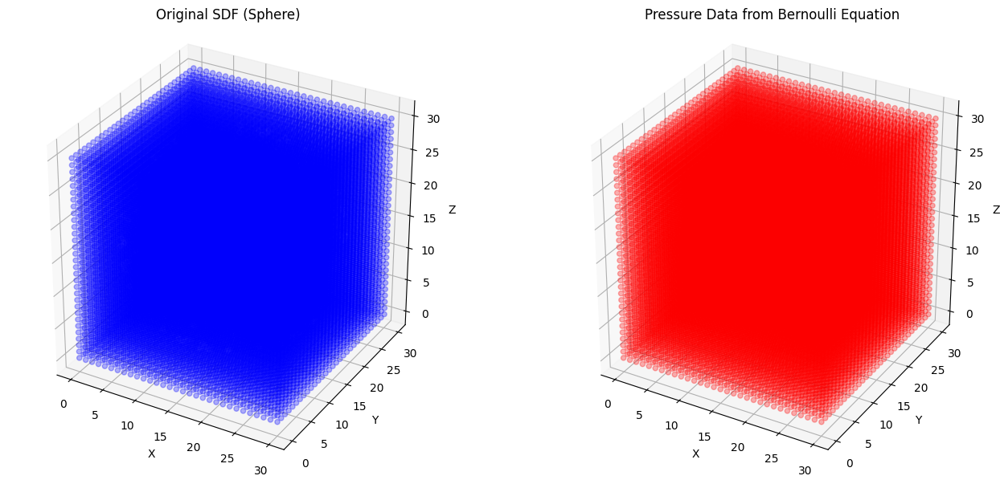

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to create a 3D sphere and compute its SDF
def create_sphere(radius, grid_size):
    # Create a 3D grid
    x = np.linspace(-radius, radius, grid_size)
    y = np.linspace(-radius, radius, grid_size)
    z = np.linspace(-radius, radius, grid_size)
    X, Y, Z = np.meshgrid(x, y, z)

    # Calculate the SDF for the sphere
    sdf = np.sqrt(X**2 + Y**2 + Z**2) - radius
    return sdf

# Function to generate velocity field around the sphere
def generate_velocity_field(sdf):
    # Normalize the distance from the sphere surface
    distance = np.clip(sdf, 0, None)  # Ignore negative values (inside the sphere)
    velocity_magnitude = 1 / (1 + distance)  # Example velocity field, decreases with distance
    return velocity_magnitude

# Function to calculate pressure data using the Bernoulli equation
def calculate_pressure(velocity, rho=1.0):
    constant = 1.0  # Define a constant pressure
    pressure = constant - 0.5 * rho * velocity**2
    return pressure

# Function to calculate curvature from SDF
def compute_curvature(sdf, dx=1):
    # Compute gradients
    gradient_x = np.gradient(sdf, dx, axis=0)
    gradient_y = np.gradient(sdf, dx, axis=1)
    gradient_z = np.gradient(sdf, dx, axis=2)
    # Calculate curvature
    curvature = np.sqrt(gradient_x**2 + gradient_y**2 + gradient_z**2)
    return curvature

# Function to perform POD using SVD
def perform_pod(snapshot_matrix):
    U, s, Vt = np.linalg.svd(snapshot_matrix, full_matrices=False)
    return U, s, Vt

# Function to reconstruct shape using POD modes
def reconstruct_shape(U, s, Vt, num_modes):
    return np.dot(U[:, :num_modes], np.diag(s[:num_modes])).dot(Vt[:num_modes, :])

# Parameters
radius = 1.0
grid_size = 31  # Grid size for the 3D shape
n_samples = 1   # Only one sample in this case

# Create sphere and compute SDF
sdf = create_sphere(radius, grid_size)

# Generate velocity field based on SDF
velocity_field = generate_velocity_field(sdf)

# Calculate pressure data using Bernoulli's equation
pressure_data = calculate_pressure(velocity_field)

# Compute curvature from SDF
curvature_data = compute_curvature(sdf)

# Create snapshot matrix: Combine SDF, pressure data, and curvature data
snapshot_matrix = np.concatenate(
    (sdf.flatten()[np.newaxis, :],
     pressure_data.flatten()[np.newaxis, :],
     curvature_data.flatten()[np.newaxis, :]),
    axis=0
)

# Perform POD
U, s, Vt = perform_pod(snapshot_matrix)

# Reconstruct the shape using the first mode
num_modes_to_use = 1
reconstructed_shape = reconstruct_shape(U, s, Vt, num_modes_to_use)

# Visualize the original SDF and the pressure data
fig = plt.figure(figsize=(14, 6))

# Original SDF Visualization
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
ax1.scatter(np.nonzero(sdf)[0], np.nonzero(sdf)[1], np.nonzero(sdf)[2], c='blue', alpha=0.3)
ax1.set_title('Original SDF (Sphere)')
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')
ax1.set_box_aspect([1, 1, 1])  # Equal aspect ratio

# Pressure Data Visualization
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
ax2.scatter(np.nonzero(pressure_data)[0], np.nonzero(pressure_data)[1], np.nonzero(pressure_data)[2], c='red', alpha=0.3)
ax2.set_title('Pressure Data from Bernoulli Equation')
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')
ax2.set_box_aspect([1, 1, 1])  # Equal aspect ratio

plt.tight_layout()
plt.show()


In [ ]:
!pip install torch

In [ ]:
!pip3 install matplotlib transforms3d future typing numpy quadpy\
             numpy-stl==2.16.3 h5py sympy==1.5.1 termcolor psutil\
             symengine==0.6.1 numba Cython chaospy torch_optimizer\
             vtk chaospy termcolor omegaconf hydra-core==1.1.1 einops\
             timm tensorboard pandas orthopy ndim functorch pint

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 772.1/772.1 kB 14.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 722.0/722.0 kB 23.6 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


In [ ]:
!pip install nvidia-modulus nvidia-modulus-sym

  Using cached nvidia_modulus_sym-1.7.0.tar.gz (220 kB)
  Installing build dependencies ... canceled
ERROR: Operation cancelled by user
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 179, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/req_command.py", line 67, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 377, in run
    requirement_set = resolver.resolve(
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/resolution/resolvelib/resolver.py", line 95, in resolve
    result = self._result = resolver.resolve(
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/resolvelib/resolvers.py", line 546, in resolve
    state = resolution.resolve(requirements, max_rounds=max_rounds)
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/res

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import modulus
from modulus.key import Key
from modulus.models import FullyConnectedArch
from modulus.dataset import PointSet
from modulus.node import Node
from modulus.domain import Domain
from modulus.evaluator import Evaluator
from modulus.trainer import Trainer
from modulus.pde import PDE

# Define a simple PDE for pressure using Bernoulli's equation
class BernoulliPDE(PDE):
    def __init__(self, rho=1.0):
        super().__init__()
        self.rho = rho  # fluid density

    def forward(self, inputs):
        P, v = inputs['P'], inputs['v']
        return P + 0.5 * self.rho * v**2

# Create a 3D sphere and compute its SDF
def create_sphere(radius, grid_size):
    # Create a 3D grid
    x = np.linspace(-radius, radius, grid_size)
    y = np.linspace(-radius, radius, grid_size)
    z = np.linspace(-radius, radius, grid_size)
    X, Y, Z = np.meshgrid(x, y, z)

    # Calculate the SDF for the sphere
    sdf = np.sqrt(X**2 + Y**2 + Z**2) - radius
    return sdf

# Function to generate velocity field around the sphere
def generate_velocity_field(sdf):
    distance = np.clip(sdf, 0, None)  # Ignore negative values (inside the sphere)
    velocity_magnitude = 1 / (1 + distance)  # Example velocity field
    return velocity_magnitude

# Parameters
radius = 1.0
grid_size = 31  # Grid size for the 3D shape

# Create sphere and compute SDF
sdf = create_sphere(radius, grid_size)

# Generate velocity field based on SDF
velocity_field = generate_velocity_field(sdf)

# Prepare data for training
points = np.array(np.nonzero(sdf)).T  # Get points on the grid where SDF is defined
pressures = 1.0 - 0.5 * (velocity_field[points[:, 0], points[:, 1], points[:, 2]] ** 2)

# Define input and output keys for the network
input_key = Key('x', 3)  # 3D input for coordinates
output_key = Key('P')  # Output for pressure

# Create the dataset
dataset = PointSet(inputs=points, outputs=pressures)

# Create a neural network architecture
model = FullyConnectedArch(input_key=input_key, output_key=output_key, num_layers=4, num_units=64)

# Create the domain for Modulus
domain = Domain(pde=BernoulliPDE(), datasets=[dataset])

# Create a trainer
trainer = Trainer(domain=domain, models=[model], n_epochs=500)

# Train the model
trainer.train()

# Evaluate the model to get pressure predictions
evaluator = Evaluator(domain)
pressure_predictions = evaluator.evaluate(points)

# Visualize the original SDF and the pressure data
fig = plt.figure(figsize=(14, 6))

# Original SDF Visualization
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
ax1.scatter(np.nonzero(sdf)[0], np.nonzero(sdf)[1], np.nonzero(sdf)[2], c='blue', alpha=0.3)
ax1.set_title('Original SDF (Sphere)')
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')
ax1.set_box_aspect([1, 1, 1])  # Equal aspect ratio

# Pressure Data Visualization
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
ax2.scatter(points[:, 0], points[:, 1], points[:, 2], c=pressure_predictions, cmap='jet', alpha=0.3)
ax2.set_title('Pressure Data from Neural Network')
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')
ax2.set_box_aspect([1, 1, 1])  # Equal aspect ratio

plt.tight_layout()
plt.show()


ModuleNotFoundError: No module named 'modulus.key'

In [ ]:
!pip list


Package                            Version
---------------------------------- -------------------
absl-py                            1.4.0
accelerate                         0.34.2
aiobotocore                        2.15.2
aiohappyeyeballs                   2.4.3
aiohttp                            3.10.10
aioitertools                       0.12.0
aiosignal                          1.3.1
alabaster                          0.7.16
albucore                           0.0.16
albumentations                     1.4.15
altair                             4.2.2
annotated-types                    0.7.0
anyio                              3.7.1
argon2-cffi                        23.1.0
argon2-cffi-bindings               21.2.0
array_record                       0.5.1
arviz                              0.19.0
asciitree                          0.3.3
astropy                            6.1.4
astropy-iers-data                  0.2024.10.7.0.32.46
astunparse                         1.6.3
async-timeout   